![](https://www.selexium.com/app/uploads/2021/05/Comment-detecter-les-fake-news-financieres-e1620648593193.jpg)


----
### <center>The project focuses on Fake News Detection.</center>

*The dataset used for this project is the Fake News Challenge (FNC-1), which was downloaded from Kaggle. The FNC-1 dataset consists of pairs of news articles (usually in the form of headlines) and their corresponding claims, along with their respective stance labels. Each instance includes:*
1. Headline: A concise statement that serves as a claim or a piece of information.
2. Body Text: The main content of a news article.
3. Stance Label: This label indicates the relationship between the headline and the body text, which can be one of the following:
- - 'agree'
- - 'disagree'
- - 'discuss'
- - 'unrelated."
----

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns
import string
from wordcloud import WordCloud
from collections import Counter
from gensim.models import TfidfModel
from gensim.corpora import Dictionary
from gensim.models import LsiModel
from gensim.models import LdaModel
from pprint import pprint
import pyLDAvis
from pyLDAvis import gensim
import nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk import word_tokenize
from nltk.corpus import stopwords
stop_words = stopwords.words("english")
from nltk.stem import PorterStemmer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
# text similarity
from sklearn.feature_extraction.text import TfidfVectorizer
# Sentiment analysis
from textblob import TextBlob

[nltk_data] Downloading package stopwords to C:\Users\Rodrigo
[nltk_data]     Torres\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to C:\Users\Rodrigo
[nltk_data]     Torres\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


# 1. Descriptive analysis
--- 
## 1.1. Loading the data
---

In [2]:
df_1 = pd.read_csv('data/train_bodies.csv')
df_2 = pd.read_csv('data/train_stances.csv')

---
## 1.2. Global overview of the data
---

In [3]:
# Joining both dataset
data = pd.merge(df_1, df_2, on='Body ID', how='left')
data.head()

,Body ID,articleBody,Headline,Stance
0,0,A small meteorite crashed into a wooded area i...,"Soldier shot, Parliament locked down after gun...",unrelated
1,0,A small meteorite crashed into a wooded area i...,Tourist dubbed ‘Spider Man’ after spider burro...,unrelated
2,0,A small meteorite crashed into a wooded area i...,Luke Somers 'killed in failed rescue attempt i...,unrelated
3,0,A small meteorite crashed into a wooded area i...,BREAKING: Soldier shot at War Memorial in Ottawa,unrelated
4,0,A small meteorite crashed into a wooded area i...,Giant 8ft 9in catfish weighing 19 stone caught...,unrelated


In [4]:
# Checking on the shape, missing values and duplicates
print('The shape of the dataset (rows, cols) is ' + str(data.shape))
print('The number of missing values in the dataset are ' + str(data.isna().sum().sum()))
print('The number of duplicates in the dataset are ' + str(data.duplicated().sum()))

The shape of the dataset (rows, cols) is (49972, 4)
The number of missing values in the dataset are 0


The number of duplicates in the dataset are 402


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49972 entries, 0 to 49971
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Body ID      49972 non-null  int64 
 1   articleBody  49972 non-null  object
 2   Headline     49972 non-null  object
 3   Stance       49972 non-null  object
dtypes: int64(1), object(3)
memory usage: 1.5+ MB


In [6]:
data.Stance.unique()

array(['unrelated', 'agree', 'discuss', 'disagree'], dtype=object)

-- --
- **There are 49972 rows and 4 columns in the dataset.**
- **There aren't any missing values.**
- **There are 402 duplicates in the dataset.**
- **There are 3 object columns and one integer column in the dataset.**
- **There are 4 categories in the 'Stance' column, which correspond to 'unrelated', 'agree', 'discuss', and 'disagree' in relation to the 'Headline'.**
-- --

# 2. Data Cleaning
--- 
## 2.1. Duplicates
---

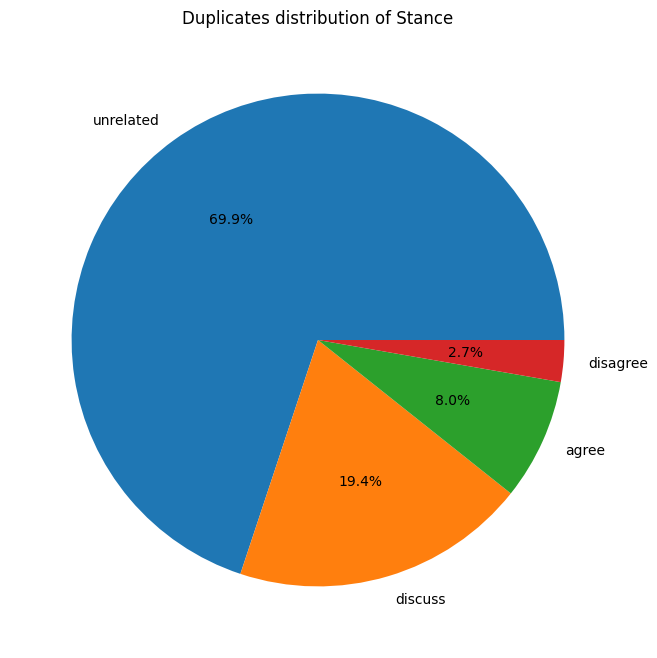

In [7]:
duplicates = data[data.duplicated(keep=False)]
duplicates_count = duplicates.Stance.value_counts()
plt.figure(figsize=(10, 8))
plt.pie(duplicates_count, labels=duplicates_count.index, autopct='%1.1f%%')
plt.title("Duplicates distribution of Stance")
plt.show()

---
- **69.9% of the duplicates are in the 'unrelated' class, which is the predominant one. Since the dataset is imbalanced, we are going to drop the duplicates from the 'unrelated' class.**
---

In [8]:
# Drop duplicates from 'unrelated'
# Identify duplicates in the 'unrelated' class
duplicates_to_drop = data[data['Stance'] == 'unrelated'].duplicated()
# Invert the boolean Series to keep non-duplicate rows in 'unrelated' class
data_2 = data[~(duplicates_to_drop & (data['Stance'] == 'unrelated'))]

# 3. Data Exploration
---
## 3.1. Data Distribution Analysis
---

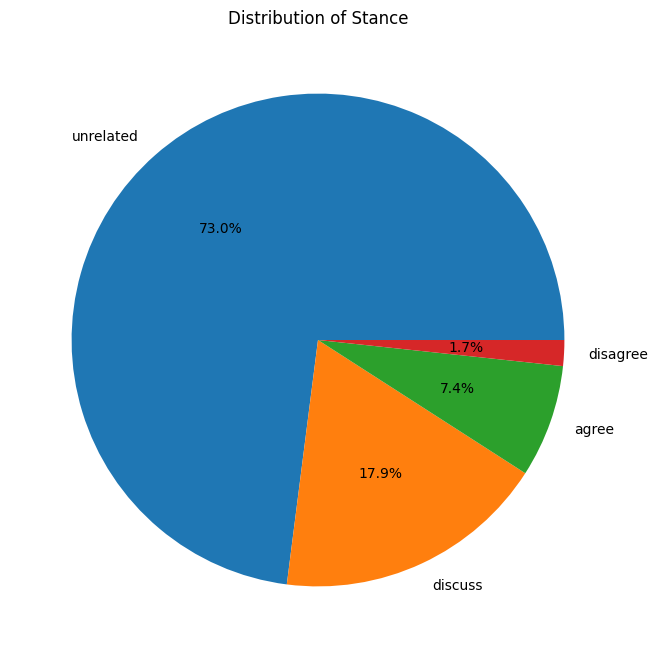

In [9]:
# distribution of Stance feature
stance_count = data_2.Stance.value_counts()
plt.figure(figsize=(12, 8))
plt.pie(stance_count, labels=stance_count.index, autopct='%1.1f%%')
plt.title("Distribution of Stance")
plt.show()

-- --
- **73% of the samples in the dataset have headlines and article bodies that are considered unrelated to each other, while 17.9% discuss of the samples have headlines and article bodies that engage in discussion, 7.4% of the samples show agreement between the headlines and article bodies, and only 1.7% of the samples have headlines and article bodies that express disagreement.**
- *We can observe that the dataset is imbalance. The unrelated class dominates the distribution with 73%.*
-- --

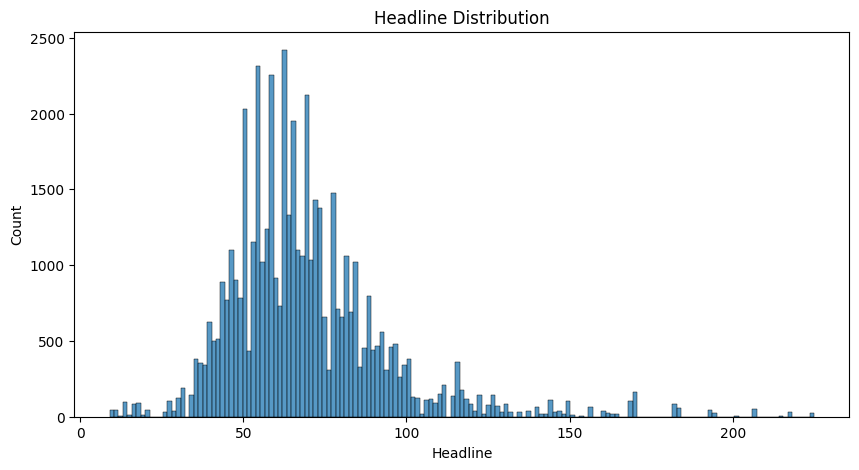

In [10]:
# headlines distribution
headline_len = data_2.Headline.apply(len)
plt.figure(figsize=(10, 5))
plt.title('Headline Distribution')
sns.histplot(headline_len)
plt.show()

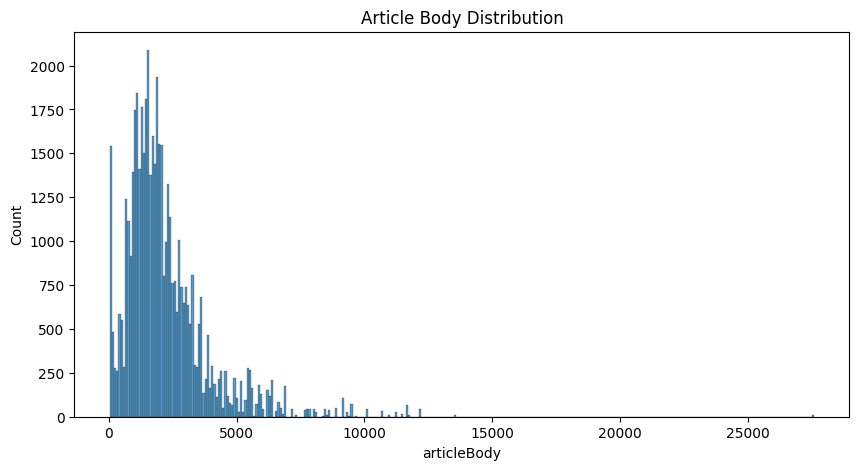

In [11]:
# articleBody distribution
article_len = data_2.articleBody.apply(len)
plt.figure(figsize=(10, 5))
plt.title('Article Body Distribution')
sns.histplot(article_len)
plt.show()

---
## 3.2. Text Analysis
---

C:\Users\Rodrigo Torres\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


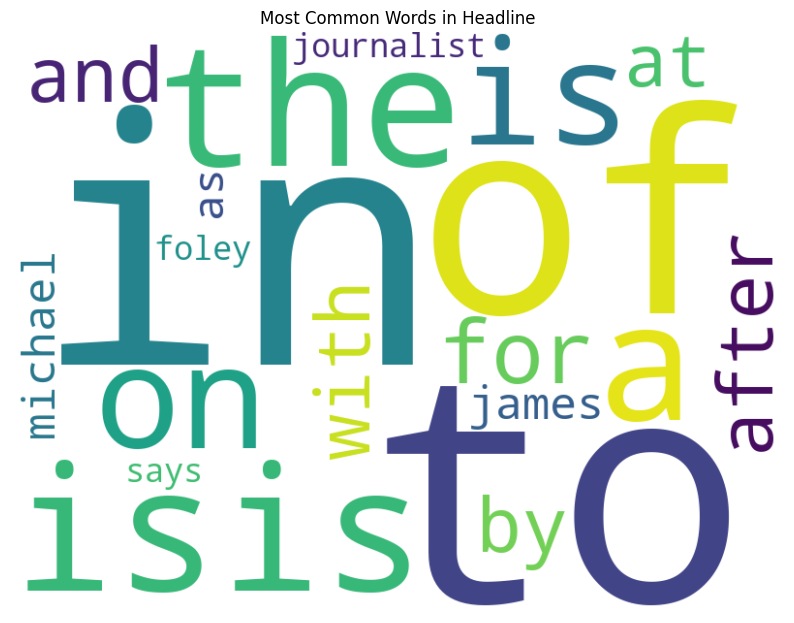

In [12]:
# Most common words in for 'Headline' '
headline_text = data_2['Headline'] 
# Tokenize words and count words frequencies
word_tokens = ' '.join(headline_text).lower().split()
word_frequencies = Counter(word_tokens)

# Most common words
most_common_words = word_frequencies.most_common(20)

wordcloud = WordCloud(width=800, height=600, background_color='white').generate_from_frequencies(dict(most_common_words))
plt.figure(figsize=(10, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Most Common Words in Headline')
plt.show()

C:\Users\Rodrigo Torres\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


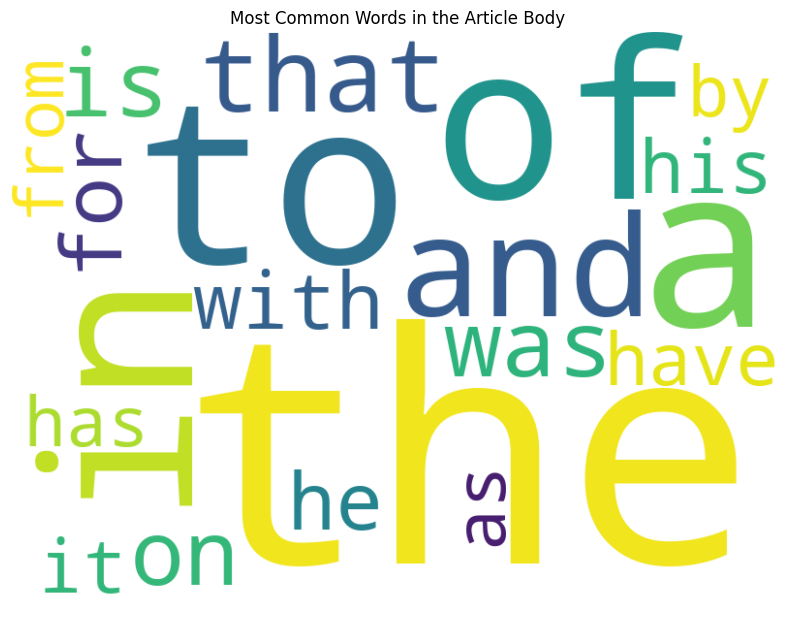

In [13]:
# Most common words in for 'Headline' '
article_text = data_2['articleBody'] 
# Tokenize words and count words frequencies
word_tokens = ' '.join(article_text).lower().split()
word_frequencies = Counter(word_tokens)

# Most common words
most_common_words = word_frequencies.most_common(20)

wordcloud = WordCloud(width=800, height=600, background_color='white').generate_from_frequencies(dict(most_common_words))
plt.figure(figsize=(10, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Most Common Words in the Article Body')
plt.show()

---
## 3.3. Text Similarity
---

In [14]:

df_2 = data_2.copy()
# Set random seed for reproducibility
random_seed = 42
df_sample = df_2.sample(n=10000, random_state=random_seed)
vectorizer = TfidfVectorizer(stop_words='english')
tf_idf_headline = vectorizer.fit_transform(df_sample['Headline']).toarray()
tf_idf_article_body = vectorizer.transform(df_sample['articleBody']).toarray()
# Calculate cosine similarity
cosine_similarities = cosine_similarity(tf_idf_headline, tf_idf_article_body)
#print("Cosine Similarities:")
#print(cosine_similarities)
# Calculate the mean cosine similarity
mean_cosine_similarity = cosine_similarities.mean()
print("Mean Cosine Similarity between Headline and Article Body:", mean_cosine_similarity)

Mean Cosine Similarity between Headline and Article Body: 0.014265629083680986


In [15]:
for i in range(len(df_sample)):
    headline = df_sample.iloc[i, df_sample.columns.get_loc('Headline')]
    article = df_sample.iloc[i, df_sample.columns.get_loc('articleBody')]
    shared_context = cosine_similarities[i, i]
    stance = df_sample.iloc[i, df_sample.columns.get_loc('Stance')]

    print(f"Example {i + 1} - Stance: {stance}")
    print('Headline:', headline)
    print('Article Body:', article)
    print(f"Shared Context (Cosine Similarity): {shared_context:.4f}")
    print('-'*50)

Example 1 - Stance: discuss
Headline: Missing jetliners raise fear of new 9/11-style attacks after Libyan airport falls to Islamic militants
Article Body: Eleven commercial jets have reportedly been stolen in recent weeks in Libya, and Western intelligence agencies have begun warning they could be used in terror attacks on Sept. 11, the anniversary of the devastating Osama bin Laden-orchestrated attacks on New York and Washington that left nearly 3,000 dead.
According to a report in the Free Beacon, the jets were taken by Islamist militias in Libya, and reports distributed within the U.S. government “included a warning that one or more of the aircraft could be used in an attack … on the date marking the anniversary of the Sept. 11, 2001, terrorist attacks …”

One official in the report assembled by the highly respected Bill Gertz said, “There are a number of commercial airliners in Libya that are missing. We found out on September 11 what can happen with hijacked planes.”

Gertz now is

---
## 2.3. Topic Modeling
---

In [16]:
# Copying the dataset
df = data_2.copy()
stemmer = PorterStemmer()
def  clean_data(text):
    
    text = text.lower()
    tokens = word_tokenize(text)
    token_punc = [t for t in tokens if t.isalpha()]
    token_stop = [t for t in token_punc if t not in stop_words]
    return token_stop

In [17]:
df['token_articleBody'] = df['articleBody'].apply(lambda x: clean_data(x))
#df.head()
# creating corpus for token_articleBody
corpus = df['token_articleBody']
id2word = Dictionary(corpus)
# Create a BOW
bow = [id2word.doc2bow(line) for line in corpus]
# Instanciate a TF-IDF
tfidf_model = TfidfModel(bow)
# Compute the TF-IDF
tf_idf_gensim = tfidf_model[bow]
# Compute the LDA
lda1 = LdaModel(corpus=tf_idf_gensim, num_topics=10, id2word=id2word, passes=10, random_state=0)
pprint(lda1.print_topics())

[(0,
  '0.035*"kim" + 0.016*"north" + 0.016*"korean" + 0.013*"korea" + '
  '0.009*"spice" + 0.009*"jong" + 0.009*"castro" + 0.007*"condom" + '
  '0.007*"pumpkin" + 0.007*"durex"'),
 (1,
  '0.011*"girls" + 0.009*"boko" + 0.009*"haram" + 0.005*"nigerian" + '
  '0.004*"nigeria" + 0.004*"drones" + 0.004*"schoolgirls" + 0.003*"students" + '
  '0.003*"marijuana" + 0.003*"school"'),
 (2,
  '0.043*"apple" + 0.029*"watch" + 0.018*"gold" + 0.012*"taliban" + '
  '0.012*"qatar" + 0.011*"basic" + 0.010*"saudi" + 0.010*"edition" + '
  '0.010*"marine" + 0.009*"michelle"'),
 (3,
  '0.004*"brown" + 0.003*"recording" + 0.003*"shots" + 0.003*"story" + '
  '0.003*"wilson" + 0.002*"cnn" + 0.002*"audio" + 0.002*"new" + 0.002*"spider" '
  '+ 0.002*"banksy"'),
 (4,
  '0.015*"culkin" + 0.014*"speed" + 0.014*"williams" + 0.012*"macaulay" + '
  '0.012*"seidel" + 0.009*"libyan" + 0.008*"jets" + 0.008*"icloud" + '
  '0.008*"gertz" + 0.008*"airbus"'),
 (5,
  '0.022*"kai" + 0.016*"scottish" + 0.014*"jobs" + 0.013*"s

In [18]:
# visuamization
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(topic_model=lda1, corpus=bow, dictionary=id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3      0.112453 -0.153260       1        1  38.049516
6      0.220499 -0.014638       2        1  23.359825
1      0.170081 -0.122219       3        1  15.213488
0      0.113506  0.036076       4        1   6.509276
9      0.076159  0.095323       5        1   5.054290
7     -0.043552  0.203894       6        1   2.682571
8     -0.209018 -0.124368       7        1   2.602243
5     -0.129649  0.027040       8        1   2.374299
2     -0.228265 -0.140861       9        1   2.241774
4     -0.082213  0.193013      10        1   1.912718, topic_info=             Term          Freq         Total Category  logprob  loglift
2630          kim  22807.000000  22807.000000  Default  30.0000  30.0000
1620        apple  20179.000000  20179.000000  Default  29.0000  29.0000
343          isis  26609.000000  26609.000000  Default  28.0000  28.0000
1673        watch  15558.000000  15558.000000  Default  27.0000  27.0000
433        border  11605.000000  11605.000000  Default  26.0000  26.0000
...           ...           ...           ...      ...      ...      ...
3073        libya   1431.667018   4548.975702  Topic10  -4.8928   2.8006
3         airport   1375.014726   4612.716372  Topic10  -4.9332   2.7463
1768        alone    990.193914   1569.719717  Topic10  -5.2615   3.4959
3016  anniversary    913.906407   2305.172501  Topic10  -5.3417   3.0315
1356       planes    902.582223   2201.584961  Topic10  -5.3541   3.0650

[508 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
3577      1  0.003488     aaron
3577      2  0.003488     aaron
3577      3  0.002325     aaron
3577      4  0.002325     aaron
3577      5  0.002325     aaron
...     ...       ...       ...
4498      6  0.979277  zeppelin
4498      7  0.002131  zeppelin
4498      8  0.002131  zeppelin
4498      9  0.002131  zeppelin
4498     10  0.002131  zeppelin

[4670 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 7, 2, 1, 10, 8, 9, 6, 3, 5])

In [19]:
df['token_Headline'] = df['Headline'].apply(lambda x: clean_data(x))
#df.head()
# creating corpus for token_Headline
corpus = df['token_Headline']
id2word = Dictionary(corpus)
# Create a BOW
bow = [id2word.doc2bow(line) for line in corpus]
# Instanciate a TF-IDF
tfidf_model = TfidfModel(bow)
# Compute the TF-IDF
tf_idf_gensim = tfidf_model[bow]
# Compute the LDA
lda1 = LdaModel(corpus=tf_idf_gensim, num_topics=10, id2word=id2word, passes=10, random_state=0)
pprint(lda1.print_topics())

[(0,
  '0.048*"james" + 0.047*"foley" + 0.045*"journalist" + 0.036*"american" + '
  '0.031*"wright" + 0.027*"islamic" + 0.027*"state" + 0.025*"beheads" + '
  '0.023*"isis" + 0.021*"beheaded"'),
 (1,
  '0.026*"weapons" + 0.025*"steve" + 0.023*"isis" + 0.022*"jobs" + '
  '0.018*"bale" + 0.018*"christian" + 0.018*"contracted" + 0.017*"ebola" + '
  '0.016*"airdrop" + 0.016*"play"'),
 (2,
  '0.046*"brown" + 0.045*"audio" + 0.042*"michael" + 0.036*"shooting" + '
  '0.021*"alleged" + 0.020*"recording" + 0.018*"isil" + '
  '0.017*"photojournalist" + 0.016*"shot" + 0.014*"cnn"'),
 (3,
  '0.024*"meteorite" + 0.018*"nicaragua" + 0.011*"says" + 0.011*"woman" + '
  '0.011*"rescue" + 0.010*"man" + 0.010*"crater" + 0.010*"yemen" + '
  '0.009*"small" + 0.009*"capital"'),
 (4,
  '0.014*"soldier" + 0.014*"war" + 0.012*"pumpkin" + 0.012*"spice" + '
  '0.011*"memorial" + 0.010*"condoms" + 0.010*"putin" + 0.009*"shot" + '
  '0.009*"bird" + 0.008*"ottawa"'),
 (5,
  '0.016*"border" + 0.015*"video" + 0.015*"i

In [20]:
# visuamization
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(topic_model=lda1, corpus=bow, dictionary=id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.232456 -0.121381       1        1  12.324139
9      0.150446 -0.186658       2        1  11.863931
1     -0.040643 -0.011194       3        1  11.041075
5     -0.167586 -0.134070       4        1  10.967864
2     -0.002169  0.243080       5        1   9.986093
6      0.068070 -0.047686       6        1   9.312165
3      0.071500 -0.019740       7        1   9.091478
4      0.173512 -0.054764       8        1   8.518406
8      0.156037  0.151377       9        1   8.481422
7     -0.176710  0.181035      10        1   8.413425, topic_info=           Term         Freq        Total Category  logprob  loglift
333       james  2373.000000  2373.000000  Default  30.0000  30.0000
332       foley  2426.000000  2426.000000  Default  29.0000  29.0000
334  journalist  2563.000000  2563.000000  Default  28.0000  28.0000
217       brown  1905.000000  1905.000000  Default  27.0000  27.0000
216       audio  1851.000000  1851.000000  Default  26.0000  26.0000
..          ...          ...          ...      ...      ...      ...
151        isis   289.842678  3791.308247  Topic10  -4.7290  -0.0958
172       ebola   242.380737  1629.755925  Topic10  -4.9078   0.5697
11          man   208.101486  1465.676315  Topic10  -5.0603   0.5233
50       gunman   189.902333   432.772583  Topic10  -5.1518   1.6516
232     islamic   190.797849  1969.144626  Topic10  -5.1471   0.1412

[569 rows x 6 columns], token_table=      Topic      Freq          Term
term                               
1567      1  0.988925     abandoned
666      10  0.992334         abdel
461       6  0.975042     abducting
2398      9  0.975106       aborted
1496      1  0.988446  accidentally
...     ...       ...           ...
1053      2  0.985145            yo
1800      9  0.988688          york
1221      9  0.974451           ypg
441       3  0.983045          zack
1646      8  0.984867      zeppelin

[1009 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 10, 2, 6, 3, 7, 4, 5, 9, 8])

---
# 4. Model
---

In [21]:
# First, we are going to count the unique words in both features 'Headline' and 'articleBody'
headline_count_words = data_2['Headline']
# Tokenize and count unique words
unique_words = set()
for headline in headline_count_words:
    tokens = word_tokenize(headline.lower()) 
    unique_words.update(tokens)
num_unique_words = len(unique_words)
print("Number of Unique Headline's Words:", num_unique_words)

Number of Unique Headline's Words: 3638


In [22]:
headline_count_words = data_2['articleBody']
# Tokenize and count unique words
unique_words = set()
for headline in headline_count_words:
    tokens = word_tokenize(headline.lower()) 
    unique_words.update(tokens)
num_unique_words = len(unique_words)
print("Number of Unique Article Body's Words:", num_unique_words)

Number of Unique Article Body's Words: 27336


---
- *The number of unique words in the article body and headlines are significantly different.*
---